In [3]:
using ClusterAnalysis, DataFrames, CSV
#using Plots, StatsPlots # replaced by PlotlyJS

In [12]:
using PlotlyJS, ClusterAnalysis, StatsBase, CSV, DataFrames

#raw = DataFrame(CSV.File("./data-ml/out.csv"))
raw = DataFrame(CSV.File("./fpt/data/output/flute-a4.csv"))

function remove_noise(data, min_power, max_frequency)
    # Noise in the onset appears at the beginning and end of the data from padding the signal 
    # with zeros on the left and right so that the window/step-size/overlap work out.
    data = data[(data.onset .!= 0) .& (data.onset .!= maximum(data.onset)), :]
    
    # good value (tested on flute-a4.wav) for min_power = 0.001
    data = data[(data.power .> min_power), :]

    # Remove frequencies above 2000 and complex part
    data = data[(0 .< data.frequency) .& (data.frequency .< max_frequency), :]
    
    return data
end

# Parameters of DBSCAN
ϵ = 0.5;
min_pts = 35;

# Denoise raw data
df = remove_noise(raw, 0.001, 2000)

# Convert data to a matrix
X = convert(Matrix, df[:,[1, 6, 8]])

# Normalize matrix
dt = fit(ZScoreTransform, X, dims=1)
mat = StatsBase.transform(dt, X)

# Run DBSCAN 
m = dbscan(mat, ϵ, min_pts); #returns object dbscan!

# # Put it into a dataframe, and plot
# print(m.labels)


# Base.print_matrix(stdout, mat)

# # https://plotly.com/julia/reference/scatter3d/

# plot(
#     df, 
#     Layout(scene = attr(
#                     xaxis_title="Onset",
#                     yaxis_title="Frequency",
#                     zaxis_title="Power"),
#                     #margin=attr(r=50, b=50, l=50, t=50)
#                     ),

#     x=df.onset, y=df.frequency, z=df.power, #color=:cluster,  
#     type="scatter3d", mode="markers", 
#     marker_size=1
# )


 -1.8800263704211542     -1.2131520495919752   -1.0740636047045962
 -1.8692531587941323     -1.2138468608832726   -0.9958813716472409
 -1.8584799471671107     -1.2137022821718708   -0.8633191985185776
 -1.8477067355400891     -1.2159674125347781   -0.6697633730984277
 -1.8369335239130675     -1.2146181808690866   -0.4271945013491017
 -1.8261603122860457     -1.2144883508905207   -0.21486329666580728
 -1.815387100659024      -1.2191918894512581    0.05420880933810466
 -1.8046138890320025      0.6531417826737272   -1.057388274410258
 -1.8046138890320025     -1.2191579669455006    0.26010194350642973
 -1.7938406774049809      0.6536731494861766   -1.0367258094949239
 -1.7938406774049809     -1.2229097967606477    0.3685485726657452
 -1.783067465777959       0.6480385884697498   -1.022075355840929
 -1.783067465777959      -1.2206193005054577    0.5090007279126687
 -1.7722942541509374      0.6499096964380201   -1.02043437142365
 -1.7722942541509374     -1.2203667577535264    0.5621792038244


 -1.2767265193079413     -0.269730303753532    -0.10116538212013686
 -1.2767265193079413     -1.212815344753979     1.1319477456647398
 -1.2659533076809195      0.6752333977978625   -0.9762850391406458
 -1.2659533076809195     -1.2123082941384198    1.1206351385766855
 -1.2659533076809195     -0.27089743941440225  -0.12028122914206264
 -1.255180096053898       0.6755812637646721   -0.998327135839837
 -1.255180096053898      -1.2115490574339163    1.1671455682665872
 -1.255180096053898      -0.2705759428950832   -0.10900879593024515
 -1.2444068844268763      0.6760626718927486   -1.0017869641085557
 -1.2444068844268763     -0.269935038916381    -0.07752309514792383
 -1.2444068844268763     -1.2104522716605215    1.166091228379894
 -1.2336336727998547      0.6805931552156415   -1.010802776488264
 -1.2336336727998547     -0.2672834683535019    0.036127080881177616
 -1.2336336727998547     -1.2106893664168086    1.1778472525187034
 -1.2228604611728329     -0.2690862950269404   -0.66592424

   0.8101544582741704
 -1.0720354983945297     -1.211126207090262     0.7397349693812659
 -1.0612622867675081      1.6233807134281049   -0.8659334106267443
 -1.0612622867675081      0.688182582815011    -1.0801833764164055
 -1.0612622867675081     -0.2629820775190137    0.6907387955625217
 -1.0612622867675081     -1.1937111828826903   -1.0834636239698916
 -1.0612622867675081     -1.2144198116459093    0.10902762829023412
 -1.0504890751404865      1.626685973102538    -0.9144343006136277
 -1.0504890751404865     -0.26554465116588627   0.6280783498662811
 -1.0504890751404865     -1.211769959837052     0.751948056635825
 -1.039715863513465       1.626107554096968    -0.9742345866703821
 -1.039715863513465      -0.26506576547568145   0.5119339420272678
 -1.039715863513465      -1.211642267815502     0.7777418034200799
 -1.028942651886443       1.6175177475275313   -1.0397055460414621
 -1.028942651886443      -0.26736570252425057   0.357381223510806
 -1.028942651886443      -1.2120509508113

  -1.0510142276343806
 -0.5980141868055768     -1.207935008350533     0.956424711533462
 -0.5872409751785552      1.6323899270677686   -0.9391904166231628
 -0.5872409751785552      0.6771398218553507   -1.0439502885558167
 -0.5872409751785552     -0.26122517108774435   0.9675169996221672
 -0.5872409751785552     -1.2072138556736132    1.0142298633303473
 -0.5764677635515335      0.6885275259916653   -1.0519538276180218
 -0.5764677635515335      1.63050052588545     -0.9553543934558444
 -0.5764677635515335     -0.26237528177672415   1.1250142434402401
 -0.5764677635515335     -1.208042295238786     1.0424622065635514
 -0.5656945519245119      1.636400231373729    -0.9711930524439764
 -0.5656945519245119      0.6888968545839677   -1.0562491226623565
 -0.5656945519245119     -0.26194322009237925   0.9743043612154483
 -0.5656945519245119     -1.207525426988233     1.0446995269878565
 -0.5549213402974902      0.6845348050004272   -1.0659097263260828
 -0.5549213402974902     -1.2081169484385

-0.3825499542651437     -0.2662334667073447    0.8046940333078715
 -0.3825499542651437      0.6733333594795379   -1.0600510309000106
 -0.3825499542651437     -1.2103092068442485    0.9862503099604789
 -0.37177674263812205     0.6805814585843365   -1.0702777452707521
 -0.37177674263812205    -0.265345401351388     0.774887963922282
 -0.37177674263812205    -1.209405223341618     1.0735591314008401
 -0.3610035310111004      0.6781451655583399   -1.0562194109682534
 -0.3610035310111004     -0.2661815631272127    0.7717682376573378
 -0.3610035310111004     -1.2097787533665996    1.0556367955555837
 -0.3502303193840787     -0.2656750610039506    0.7936490336240128
 -0.3502303193840787     -1.2075465733195858    0.9940195504365844
 -0.3502303193840787      0.6806846946063011   -1.0497843346119087
 -0.33945710775705706     0.6794274614677055   -1.0511412376331983
 -0.33945710775705706    -0.26441499610129027   0.8447121645875582
 -0.33945710775705706    -1.2089266496896973    1.04374148739046

     0.6762744488132695   -0.843036736823392
  0.06992493406976591    -1.2099399178588321    0.9792379945553112
  0.08069814569678757     0.6783592296146099   -0.8299811014423917
  0.08069814569678757    -0.26881667537673537   0.7025274358547826
  0.08069814569678757    -1.2110873359676304    1.014655651501905
  0.09147135732380923     0.6788212977144893   -0.8174466766486194
  0.09147135732380923    -0.2683548061495087    0.7921999074333166
  0.09147135732380923    -1.2098771703150193    1.0550592199326718
  0.10224456895083088     0.6804914033794246   -0.8080895520698664
  0.10224456895083088    -0.2665270069458795    0.8693142550135313
  0.10224456895083088    -1.2099053467460008    1.0886287617229236
  0.11301778057785254     0.6761650763991719   -0.8062586227604235
  0.11301778057785254    -0.26472706561185944   0.9811761217002389
  0.11301778057785254    -1.208151399086816     1.1516444469178453
  0.1237909922048742     -0.2650863127312683    1.0353894501070204
  0.12379099220487

-0.9274626379865778
  0.2853891666101991     -1.2073263441000646    0.7353349990533194
  0.2853891666101991      1.637331496259619    -1.020970703529776
  0.2853891666101991     -0.2615646289896763    1.8329666321270375
  0.2961623782372207      1.6325774682892895   -1.0232028113079126
  0.2961623782372207      0.6899725755214373   -0.9565674354065259
  0.2961623782372207     -0.2611911097548022    1.9521565452965304
  0.2961623782372207     -1.2069094617709348    0.737655301400685
  0.30693558986424235     1.6337333024571388   -0.9997545148174346
  0.30693558986424235     0.689186675969946    -0.9583225861255192
  0.30693558986424235    -0.26098248248177186   1.9734220819350776
  0.30693558986424235    -1.2071390474659809    0.7253104159241879
  0.317708801491264       1.6317548123523558   -0.971255555051499
  0.317708801491264       0.6849218522857857   -0.9727979451605394
  0.317708801491264      -0.2587675031498846    2.039529124121462
  0.317708801491264      -1.2067701467217093  


  0.694771208437022       0.6900333295278904   -0.9934428955361225
  0.694771208437022      -0.25860388788809324   0.8446215494927898
  0.694771208437022      -1.2062439323010732    0.9925361115626483
  0.7055444200640437      1.6345698725959517   -0.9129859273350007
  0.7055444200640437      0.6851187696142155   -0.9091195353174268
  0.7055444200640437     -0.2586208980853091    0.8967357330382844
  0.7055444200640437     -1.2060452117721796    1.0016332634148704
  0.7163176316910653      1.6400443746587723   -0.9408901996957001
  0.7163176316910653      0.6932865763346361   -0.9595464136732234
  0.7163176316910653     -1.2064928418257101    0.9783201258452661
  0.7163176316910653     -0.2583593326344209    0.9404399182666431
  0.727090843318087       1.6394400891566334   -0.9561633343707977
  0.727090843318087      -1.2062256383942112    0.920381224750395
  0.727090843318087       0.690735269708011    -0.9547187433329297
  0.727090843318087      -0.25851346316380514   0.964860015535

   0.8698102304474221
  0.9317818642314984     -0.2564320864234228    0.9631821345324749
  0.9425550758585202      1.6446985496141195   -0.962778095358405
  0.9425550758585202      0.6985986878887561   -0.9390902781633073
  0.9425550758585202     -0.2547934871530753    0.9639152122876598
  0.9425550758585202     -1.20409187913146      0.8753900502737934
  0.9533282874855418     -0.2543366383370913    0.9514349155501273
  0.9533282874855418     -1.2042514115234275    0.8667863006029859
  0.9533282874855418      1.6453199552681337   -0.9644818032686657
  0.9533282874855418      0.6956336863527676   -0.9296111671152133
  0.9641014991125635     -0.25554737520853904   0.9066682000764761
  0.9641014991125635      1.6407178934280269   -0.9384993583509893
  0.9641014991125635      0.6954905554516433   -0.9093111117547338
  0.9641014991125635     -1.2030226468248735    0.841577209500338
  0.9748747107395851     -0.25524717710933914   0.8676202489488535
  0.9748747107395851      1.63938825994739

    -1.055944363930902
  1.4273495990744947     -0.26666980087049963   0.13625259346359936
  1.4273495990744947      0.6750765852138336   -1.0449050579936856
  1.4273495990744947     -1.2112732555132273    1.8850694285451182
  1.4381228107015165      0.6819509667583871   -1.0422570016104964
  1.4381228107015165     -0.265460841966323     0.059561242251853455
  1.4381228107015165     -1.2111329971285327    1.878646099028832
  1.4381228107015165      1.6112212913180994   -1.0849021150640221
  1.448896022328538       0.6799848064038974   -1.0510161004116951
  1.448896022328538      -0.2668222277195092   -0.0006305222710467254
  1.448896022328538      -1.2116960554509073    1.833003672394119
  1.4596692339555597      0.6828256876895202   -1.0587694678661905
  1.4596692339555597     -0.26840821987106034  -0.09202653869788338
  1.4596692339555597     -1.2127057605775862    1.7782244028755008
  1.4596692339555597      1.6157020381214786   -1.058498146139811
  1.4704424455825813     -0.2661267

-0.8583722060052269
  1.664360254868971      -1.2132594069278335    0.8403541635857827
  1.675133466495993      -0.26347387094952773  -0.9150184173758787
  1.675133466495993      -1.2134452389728505    0.784999067574796
  1.6859066781230145     -0.27046668284699166  -0.990831506326344
  1.6859066781230145     -1.2135955933047504    0.6897575758071451
  1.6966798897500361     -0.26932158677108925  -1.0418902808130004
  1.6966798897500361     -1.2142369618160225    0.598180343251824
  1.7074531013770577     -0.26573787110611335  -1.0815140608507277
  1.7074531013770577     -1.21585784616885      0.4979128077862591
  1.7074531013770577      1.610242678221073    -1.08894155937585
  1.7182263130040796      1.610218676052772    -1.0887190611889803
  1.7182263130040796     -1.215570634383297     0.401545722355972
  1.7289995246311012     -1.2149291383084448    0.32639407647665186
  1.7397727362581228     -1.214596897093365     0.2722348580527074
  1.7505459478851444     -1.214463197746985    

In [4]:
# load blob dataset 
# df = CSV.read("./fpt/data/output/flute-a4.csv", DataFrame);
df = DataFrame(CSV.File("./fpt/data/output/flute-a4.csv"))
# X = df[:,1]; # add freq as well (row 6)
# y = df[:,2];

mat = convert(Matrix,df[:,[1, 7, 8]])

# # parameters of k-means
ϵ = 0.5;
min_pts = 35;

mat

68767×3 Matrix{Float64}:
     0.0    -1.43949   2.83878e-9
     0.0    -1.43949   2.83878e-9
     0.0    -0.869687  3.17786e-9
     0.0    -0.869687  3.17786e-9
     0.0   -11.6824    1.05152e-9
     0.0   -11.6824    1.05152e-9
     0.0   -21.8374    1.65871e-9
     0.0   -21.8374    1.65871e-9
     0.0    -2.56526   1.15493e-9
     0.0    -2.56526   1.15493e-9
     ⋮                 
 94750.0  -959.485     0.000217246
 94750.0  -959.485     0.000217246
 94750.0  -960.57      0.000109382
 94750.0  -960.57      0.000109382
 94750.0  -958.238     2.53224e-5
 94750.0  -958.238     2.53224e-5
 94750.0  -943.297     9.51003e-6
 94750.0  -943.297     9.51003e-6
 94750.0  -938.568     1.5626e-5

In [5]:
#mat = [1 2 8; 3 4 2; 6 4 1; 2 5 3; 3 1 8; 3 9 0; 9 4 2;]

m = dbscan(mat, ϵ, min_pts);
m

DBSCAN{Float64, NearestNeighbors.KDTree{StaticArraysCore.SVector{3, Float64}, Distances.Euclidean, Float64}}([0.0 -1.4394934088311313 2.838776132480524e-9; 0.0 -1.4394934088311313 2.838776132480524e-9; … ; 94750.0 -943.2968888773783 9.510030226189077e-6; 94750.0 -938.5682440272193 1.562603649625183e-5], 0.5, 35, [-1, -1, -1, -1, -1, -1, -1, -1, -1, -1  …  -1, -1, -1, -1, -1, -1, -1, -1, -1, -1], NearestNeighbors.KDTree{StaticArraysCore.SVector{3, Float64}, Distances.Euclidean, Float64}
  Number of points: 68767
  Dimensions: 3
  Metric: Distances.Euclidean(0.0)
  Reordered: true, Vector{Int64}[])

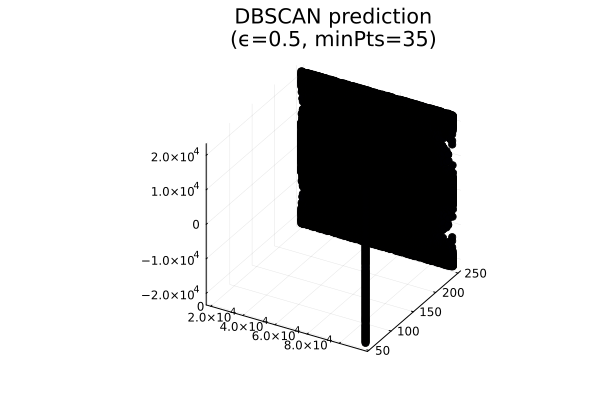

In [40]:
#m = dbscan(X, ϵ, min_pts);

scatter(mat[:,1], mat[:,2], mat[:,3], zcolor=m.labels, 
        leg=false, 
        title="DBSCAN prediction\n(ϵ=$(ϵ), minPts=$(min_pts))")

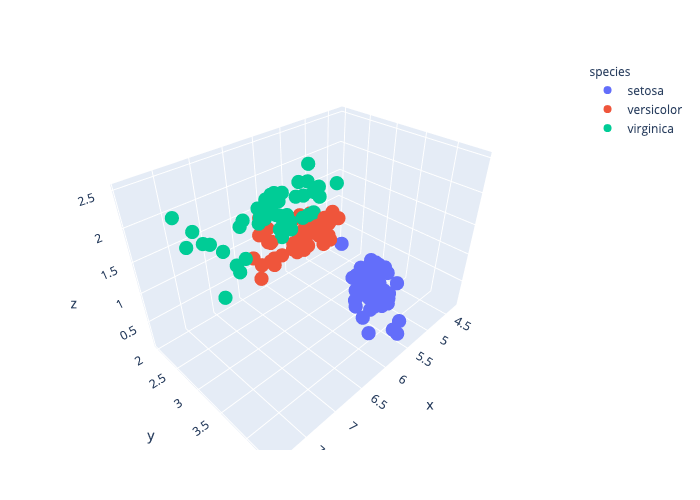

In [1]:
using PlotlyJS, CSV, DataFrames
df = dataset(DataFrame, "iris")
plot(
    df,
    x=:sepal_length, y=:sepal_width, z=:petal_width, color=:species,
    type="scatter3d", mode="markers"
)